In [2]:
# التحقق من جميع الملفات الموجودة في مجلد /kaggle/input وطباعة مساراتها، مما يُساعدك على معرفة البيانات المتوفرة للعمل عليها.
# شرح المسارات التي يمكنك استخدامها لتخزين الملفات أو العمل المؤقت عليها
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/car_data/names.csv
/kaggle/input/car_data/anno_test.csv
/kaggle/input/car_data/anno_train.csv
/kaggle/input/car_data/car_data/names.csv
/kaggle/input/car_data/car_data/anno_test.csv
/kaggle/input/car_data/car_data/anno_train.csv
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/04772.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/08033.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/03004.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/06551.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/01397.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/06801.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/00641.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/00455.jpg
/kaggle/input/car_dat

## import libraries

In [3]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.applications import Xception, DenseNet121
from keras.models import Model
from keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input
from keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, auc,confusion_matrix, ConfusionMatrixDisplay

In [4]:
train_dir = "/kaggle/input/car_data/car_data/car_data/train/" 
test_dir = "/kaggle/input/car_data/car_data/car_data/test/"   

train_classes = os.listdir(train_dir)
test_classes = os.listdir(test_dir)

print("Classes in Train:", train_classes)
print("Classes in Test:", test_classes)

extra_classes = set(train_classes) - set(test_classes)
print("Extra classes in Train:", extra_classes)


Classes in Train: ['Dodge Ram Pickup 3500 Crew Cab 2010', 'Cadillac CTS-V Sedan 2012', 'Audi S5 Convertible 2012', 'Ram C-V Cargo Van Minivan 2012', 'smart fortwo Convertible 2012', 'Audi V8 Sedan 1994', 'Suzuki Kizashi Sedan 2012', 'Chevrolet Express Van 2007', 'Chrysler Town and Country Minivan 2012', 'Rolls-Royce Phantom Sedan 2012', 'Buick Regal GS 2012', 'Aston Martin V8 Vantage Convertible 2012', 'Rolls-Royce Phantom Drophead Coupe Convertible 2012', 'Audi TT Hatchback 2011', 'Chevrolet Malibu Hybrid Sedan 2010', 'Honda Odyssey Minivan 2012', 'BMW X6 SUV 2012', 'Audi 100 Wagon 1994', 'Volvo 240 Sedan 1993', 'Plymouth Neon Coupe 1999', 'Ford Focus Sedan 2007', 'Ford GT Coupe 2006', 'McLaren MP4-12C Coupe 2012', 'Dodge Caliber Wagon 2012', 'Acura TSX Sedan 2012', 'Chrysler 300 SRT-8 2010', 'Jeep Wrangler SUV 2012', 'Chevrolet Monte Carlo Coupe 2007', 'Chevrolet HHR SS 2010', 'Dodge Dakota Crew Cab 2010', 'Jeep Compass SUV 2012', 'Hyundai Veracruz SUV 2012', 'Buick Verano Sedan 2012

In [5]:
import shutil
import os

writable_dir = "/kaggle/working/train"

shutil.copytree("/kaggle/input/car_data/car_data/car_data/train/", writable_dir)

print("Data copied to writable directory.")


Data copied to writable directory.


In [6]:
class_to_remove = "models"
class_path = os.path.join(writable_dir, class_to_remove)

if os.path.exists(class_path):
    shutil.rmtree(class_path)
    print(f"Class '{class_to_remove}' has been removed.")
else:
    print(f"Class '{class_to_remove}' not found.")


Class 'models' has been removed.


In [7]:
train_dir = '/kaggle/working/train/'  
     
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,  
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    brightness_range=[0.8, 1.2],
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 27671 images belonging to 196 classes.
Found 6846 images belonging to 196 classes.
Found 8041 images belonging to 196 classes.


## Resnet Model

In [8]:
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Define the ResNet block
def resnet_block(input_tensor, filters, kernel_size=3, strides=1):
    x = layers.Conv2D(filters, kernel_size, strides=strides, padding='same', kernel_initializer='he_normal')(input_tensor)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters, kernel_size, strides=1, padding='same', kernel_initializer='he_normal')(x)
    x = layers.BatchNormalization()(x)

    if strides > 1 or input_tensor.shape[-1] != filters:
        input_tensor = layers.Conv2D(filters, 1, strides=strides, padding='same', kernel_initializer='he_normal')(input_tensor)
        input_tensor = layers.BatchNormalization()(input_tensor)

    x = layers.Add()([x, input_tensor])
    x = layers.ReLU()(x)
    return x

# Build ResNet model
def build_resnet(input_shape, num_classes):
    inputs = layers.Input(shape=input_shape)

    # Initial Convolutional Layer
    x = layers.Conv2D(64, 7, strides=2, padding='same', kernel_initializer='he_normal')(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(x)

    # Residual Blocks
    x = resnet_block(x, 64)
    x = resnet_block(x, 64)
    x = resnet_block(x, 128, strides=2)
    x = resnet_block(x, 128)
    x = resnet_block(x, 256, strides=2)
    x = resnet_block(x, 256)
    x = resnet_block(x, 512, strides=2)
    x = resnet_block(x, 512)

    # Global Average Pooling and Output Layer
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(512, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    outputs = layers.Dense(num_classes, activation='softmax')(x)

    resnet_model = models.Model(inputs, outputs)
    return resnet_model

# Build the model
input_shape = (224, 224, 3)
num_classes = len(train_generator.class_indices)
resnet_model = build_resnet(input_shape, num_classes)
resnet_model.summary()




Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 112, 112,  │      9,472 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 112, 112,  │        256 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 112, 112,  │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 56, 56,    │          0 │ re_lu[0][0]       │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 56, 56,    │     36,928 │ max_pooling2d[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 56, 56,    │        256 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 56, 56,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 56, 56,    │     36,928 │ re_lu_1[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 56, 56,    │        256 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 56, 56,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │ max_pooling2d[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_2 (ReLU)      │ (None, 56, 56,    │          0 │ add[0][0]         │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 56, 56,    │     36,928 │ re_lu_2[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 56, 56,    │        256 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_3 (ReLU)      │ (None, 56, 56,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 56, 56,    │     36,928 │ re_lu_3[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 56, 56,    │        256 │ conv2d_4[0][0]  

 Total params: 11,554,116 (44.08 MB)

 Trainable params: 11,544,516 (44.04 MB)

 Non-trainable params: 9,600 (37.50 KB)

In [9]:
# Compile the model
resnet_model.compile(optimizer=optimizers.Adam(learning_rate=1e-4),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Set callbacks
callbacks = [
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, verbose=1),
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True, verbose=1)
]

In [11]:


# Train the model
resnet_history = resnet_model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=25,
    # class_weight=class_weights,
    callbacks=callbacks
)


Epoch 1/25


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1734418144.421729     178 service.cc:145] XLA service 0x7c0f28004a30 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734418144.421792     178 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1734418144.421797     178 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5


  1/865 ━━━━━━━━━━━━━━━━━━━━ 6:36:49 28s/step - accuracy: 0.0000e+00 - loss: 6.2124

I0000 00:00:1734418157.992333     178 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


865/865 ━━━━━━━━━━━━━━━━━━━━ 487s 532ms/step - accuracy: 0.0117 - loss: 5.3291 - val_accuracy: 0.0222 - val_loss: 5.2153 - learning_rate: 1.0000e-04
Epoch 2/25
865/865 ━━━━━━━━━━━━━━━━━━━━ 449s 516ms/step - accuracy: 0.0230 - loss: 5.1025 - val_accuracy: 0.0219 - val_loss: 5.0742 - learning_rate: 1.0000e-04
Epoch 3/25
865/865 ━━━━━━━━━━━━━━━━━━━━ 448s 515ms/step - accuracy: 0.0335 - loss: 4.9464 - val_accuracy: 0.0302 - val_loss: 5.0300 - learning_rate: 1.0000e-04
Epoch 4/25
865/865 ━━━━━━━━━━━━━━━━━━━━ 447s 513ms/step - accuracy: 0.0488 - loss: 4.7587 - val_accuracy: 0.0510 - val_loss: 4.7529 - learning_rate: 1.0000e-04
Epoch 5/25
865/865 ━━━━━━━━━━━━━━━━━━━━ 442s 507ms/step - accuracy: 0.0669 - loss: 4.5494 - val_accuracy: 0.0551 - val_loss: 4.6269 - learning_rate: 1.0000e-04
Epoch 6/25
865/865 ━━━━━━━━━━━━━━━━━━━━ 442s 508ms/step - accuracy: 0.0919 - loss: 4.2947 - val_accuracy: 0.0960 - val_loss: 4.2781 - learning_rate: 1.0000e-04
Epoch 7/25
865/865 ━━━━━━━━━━━━━━━━━━━━ 442s 508ms/

## Evaluation model 

In [14]:
# Evaluate the model on the test set
test_loss, test_accuracy = resnet_model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


252/252 ━━━━━━━━━━━━━━━━━━━━ 37s 145ms/step - accuracy: 0.4693 - loss: 2.0562
Test Accuracy: 49.01%


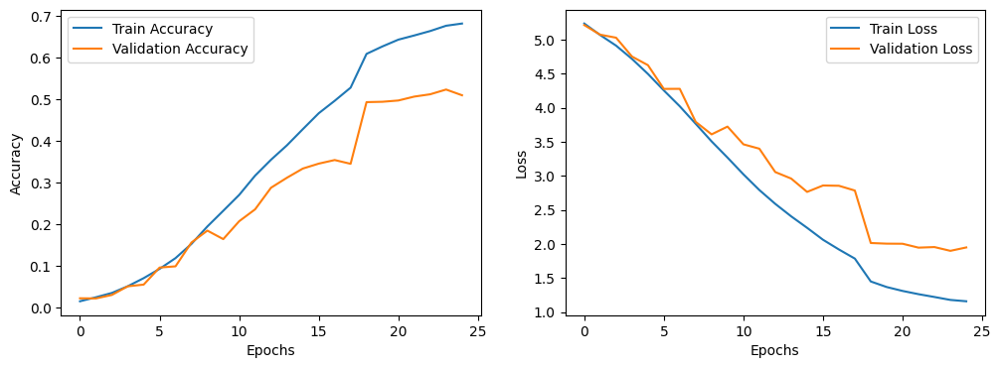

In [15]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(resnet_history.history['accuracy'], label="Train Accuracy")
plt.plot(resnet_history.history['val_accuracy'], label="Validation Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(resnet_history.history['loss'], label="Train Loss")
plt.plot(resnet_history.history['val_loss'], label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()

plt.show()


In [16]:
# Predict on the test set
y_pred = resnet_model.predict(test_generator)
y_true = test_generator.classes
y_pred_classes = np.argmax(y_pred, axis=1)

# Classification report
print("\nClassification Report:\n")
print(classification_report(y_true, y_pred_classes, target_names=test_generator.class_indices.keys()))


252/252 ━━━━━━━━━━━━━━━━━━━━ 37s 142ms/step

Classification Report:

                                                        precision    recall  f1-score   support

                            AM General Hummer SUV 2000       0.72      0.66      0.69        44
                             Acura Integra Type R 2001       0.37      0.55      0.44        44
                                   Acura RL Sedan 2012       0.62      0.41      0.49        32
                                   Acura TL Sedan 2012       0.60      0.86      0.70        43
                                  Acura TL Type-S 2008       0.66      0.55      0.60        42
                                  Acura TSX Sedan 2012       0.69      0.45      0.55        40
                              Acura ZDX Hatchback 2012       0.33      0.46      0.39        39
              Aston Martin V8 Vantage Convertible 2012       0.28      0.51      0.37        45
                    Aston Martin V8 Vantage Coupe 2012       0.32 

In [22]:
print(classification_report(test_generator.classes, y_pred_classes))

              precision    recall  f1-score   support

           0       0.72      0.66      0.69        44
           1       0.37      0.55      0.44        44
           2       0.62      0.41      0.49        32
           3       0.60      0.86      0.70        43
           4       0.66      0.55      0.60        42
           5       0.69      0.45      0.55        40
           6       0.33      0.46      0.39        39
           7       0.28      0.51      0.37        45
           8       0.32      0.22      0.26        41
           9       0.60      0.09      0.16        33
          10       0.27      0.63      0.38        38
          11       0.51      0.62      0.56        40
          12       0.30      0.14      0.19        42
          13       0.39      0.51      0.44        41
          14       0.66      0.49      0.56        43
          15       0.29      0.33      0.31        36
          16       0.24      0.42      0.31        45
          17       0.20    

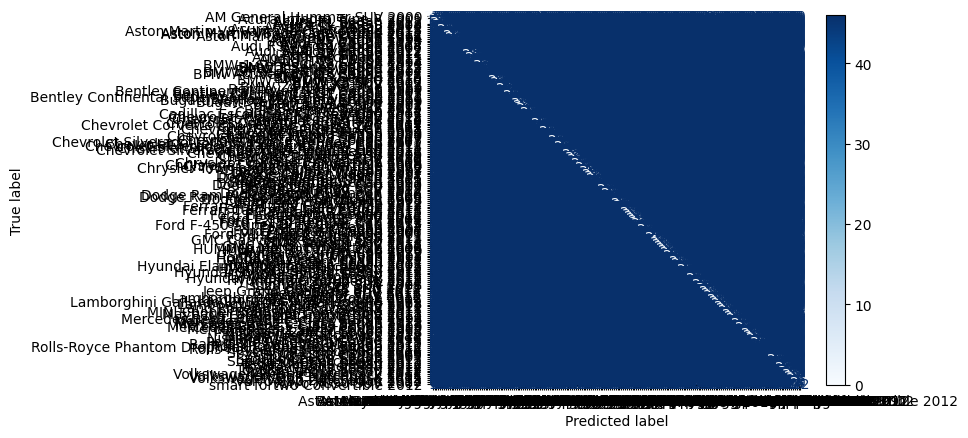

In [17]:
# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
cmd = ConfusionMatrixDisplay(cm, display_labels=test_generator.class_indices.keys())
cmd.plot(cmap=plt.cm.Blues)
plt.show()


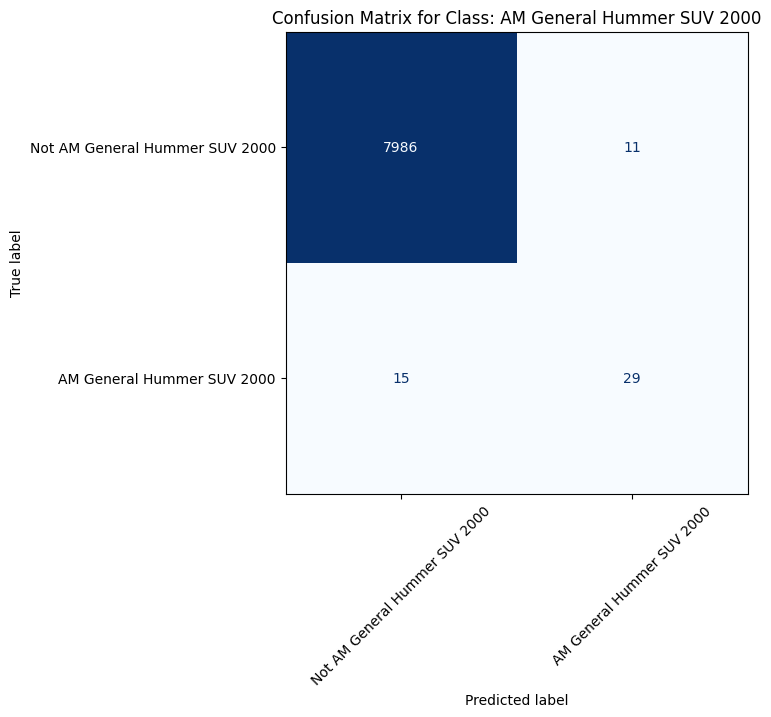

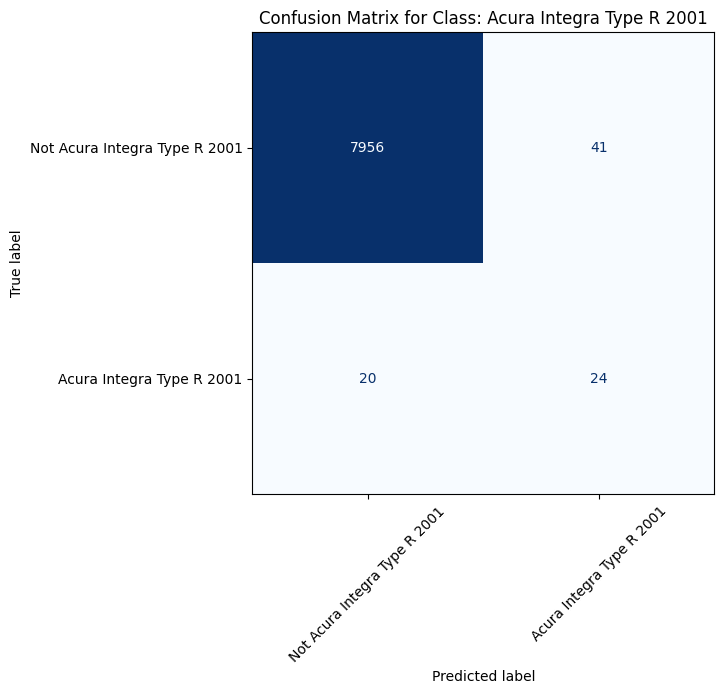

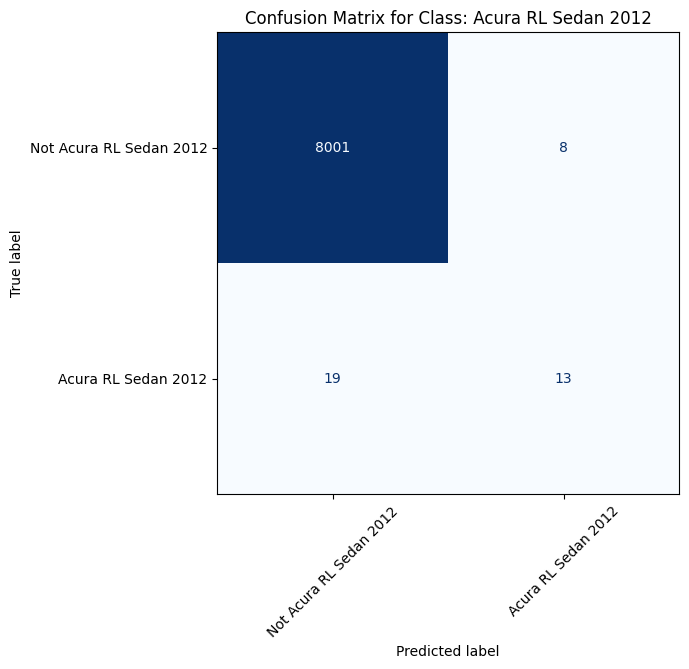

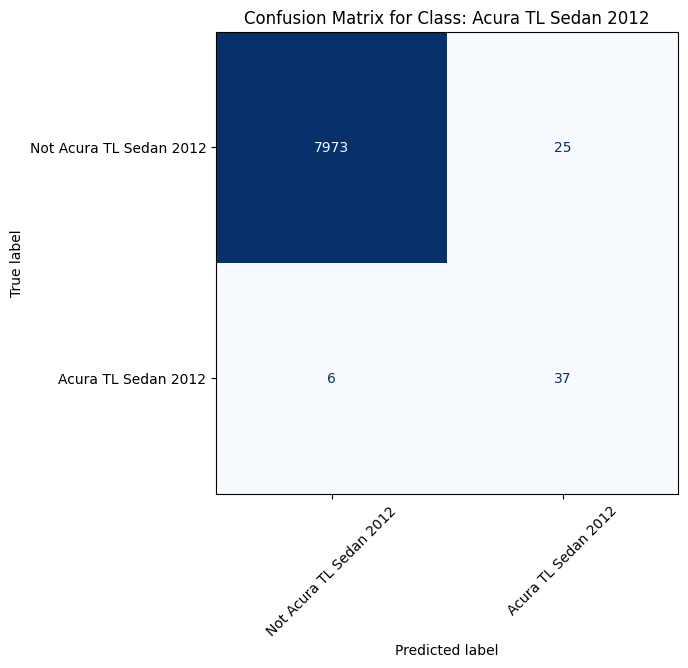

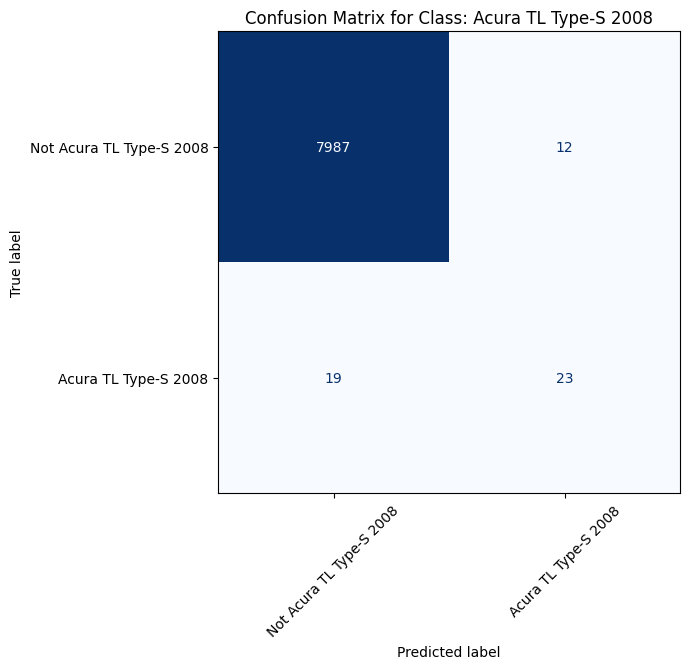

...

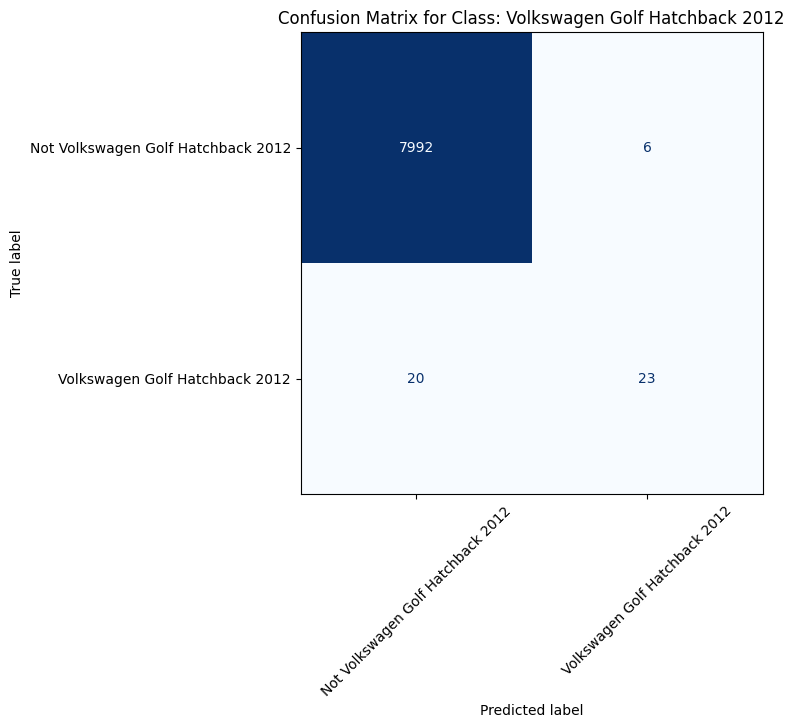

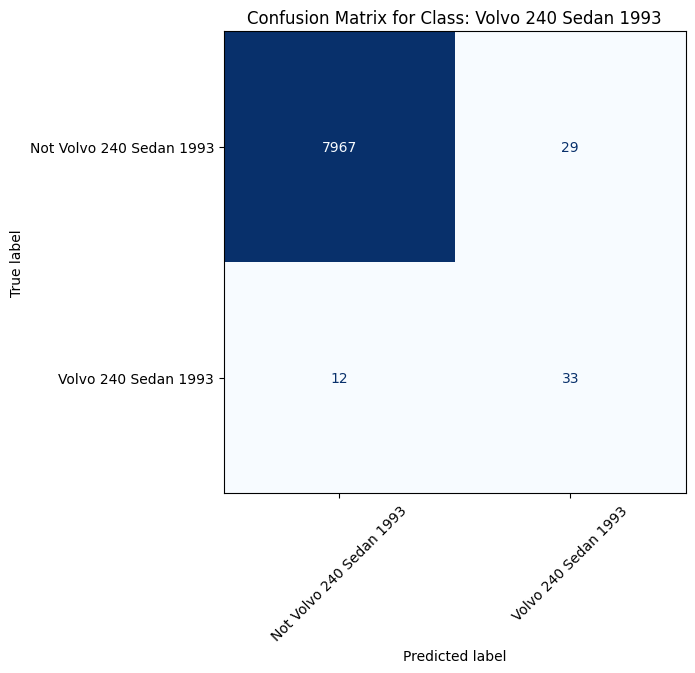

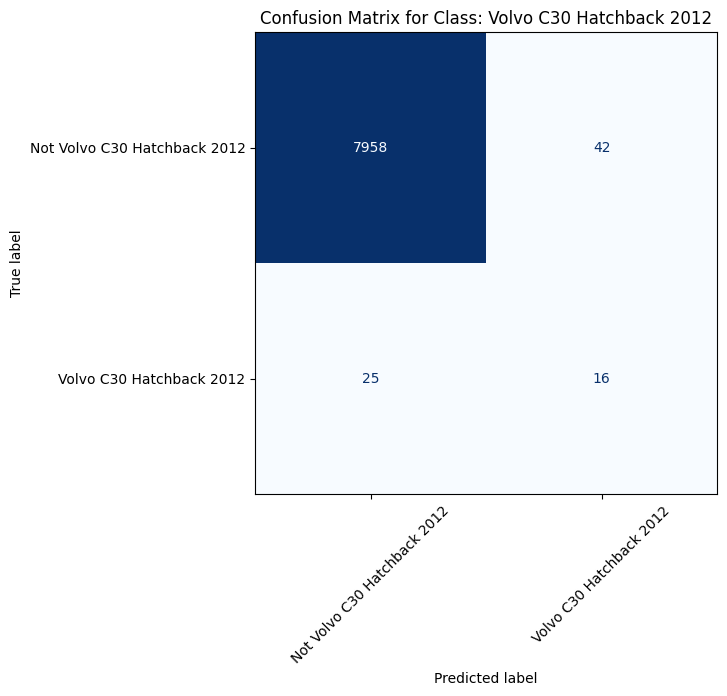

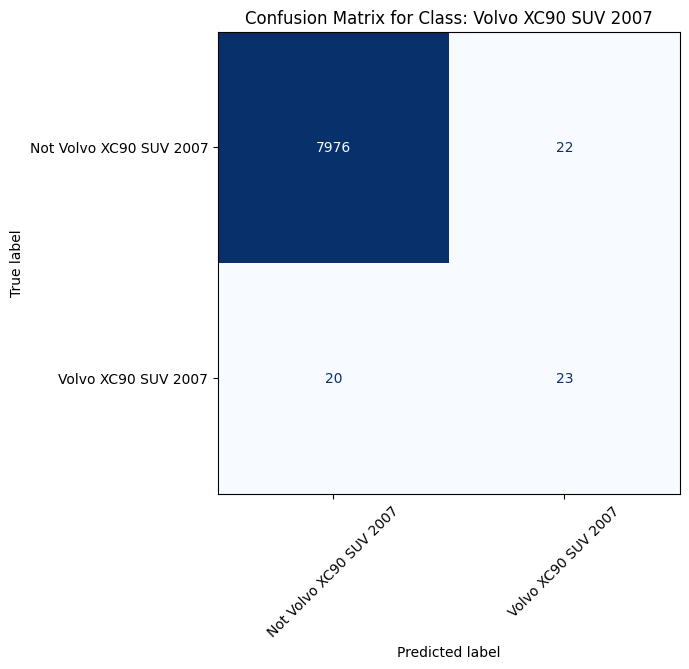

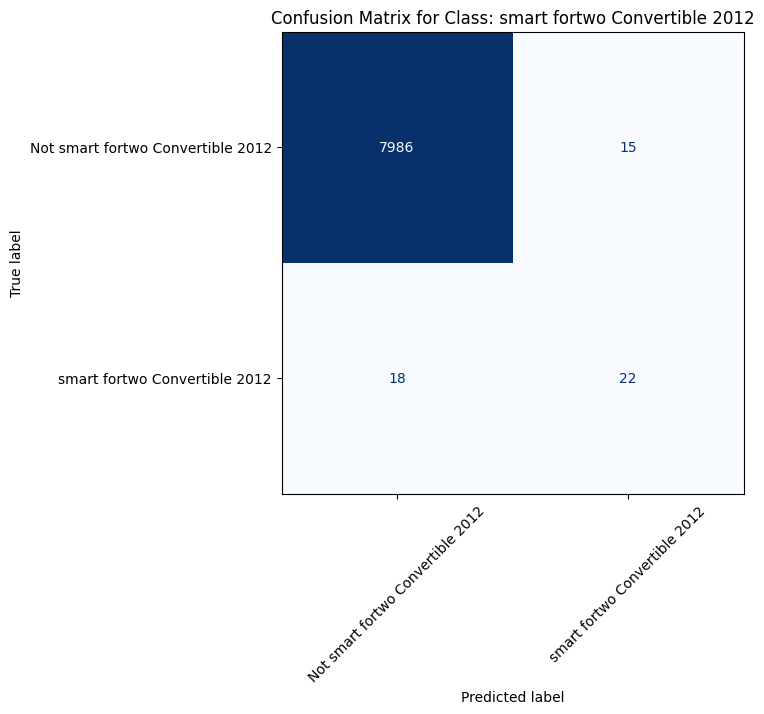

In [21]:
classlabels = list(test_generator.class_indices.keys())
# Loop through each class and create a one-vs-all confusion matrix
for i, class_label in enumerate(classlabels):
    # Binary true and predicted labels for one-vs-all
    y_true_binary = (y_true == i).astype(int)
    y_pred_binary = (y_pred_classes == i).astype(int)

    # Compute confusion matrix
    cm_one_vs_all = confusion_matrix(y_true_binary, y_pred_binary)

    # Plot confusion matrix
    fig, ax = plt.subplots(figsize=(6, 6))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_one_vs_all, display_labels=["Not " + class_label, class_label])
    disp.plot(cmap='Blues', ax=ax, colorbar=False)

    plt.title(f"Confusion Matrix for Class: {class_label}")
    plt.xticks(rotation=45)
    plt.show()

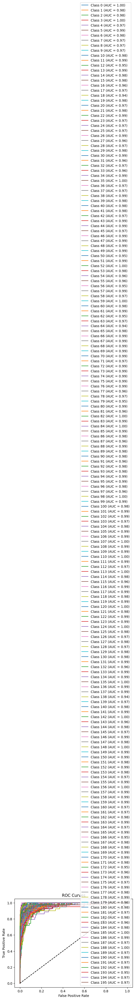

In [18]:


# ROC and AUC for each class
fpr = {}
tpr = {}
roc_auc = {}
for i in range(num_classes):
    fpr[i], tpr[i], _ = roc_curve((y_true == i).astype(int), y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curves
plt.figure()
for i in range(num_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves')
plt.legend(loc='lower right')
plt.show()

In [23]:
resnet_model.save('my_resnet_model.h5')

In [25]:
model_res = load_model('my_resnet_model.h5')

252/252 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step


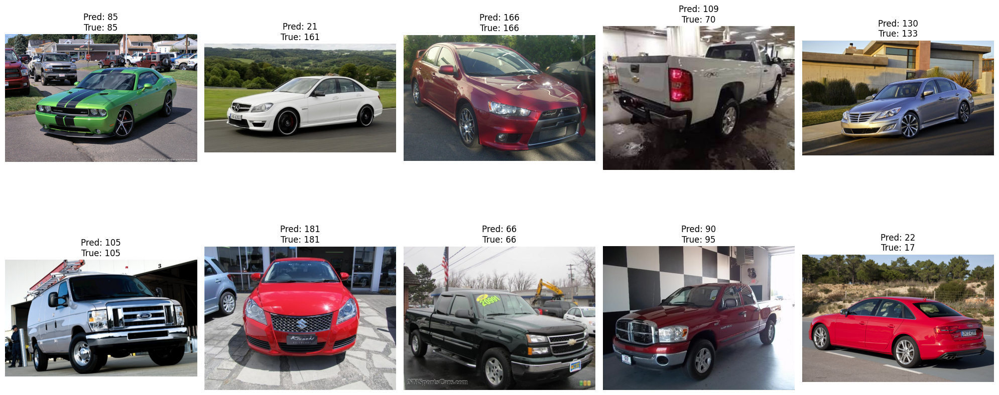

In [27]:
import random

random_indices = random.sample(range(len(test_generator.filenames)), 10)

predictions = model_res.predict(test_generator, verbose=1)
predicted_classes = np.argmax(predictions, axis=1) 
true_classes = test_generator.classes  

fig, axes = plt.subplots(2, 5, figsize=(20, 10))  

for i, idx in enumerate(random_indices):
    img_path = test_generator.filepaths[idx]  
    img = plt.imread(img_path)
    
    row = i // 5
    col = i % 5
    axes[row, col].imshow(img)
    axes[row, col].axis('off')
    axes[row, col].set_title(f"Pred: {predicted_classes[idx]}\nTrue: {true_classes[idx]}")

plt.tight_layout()
plt.show()

252/252 ━━━━━━━━━━━━━━━━━━━━ 35s 139ms/step


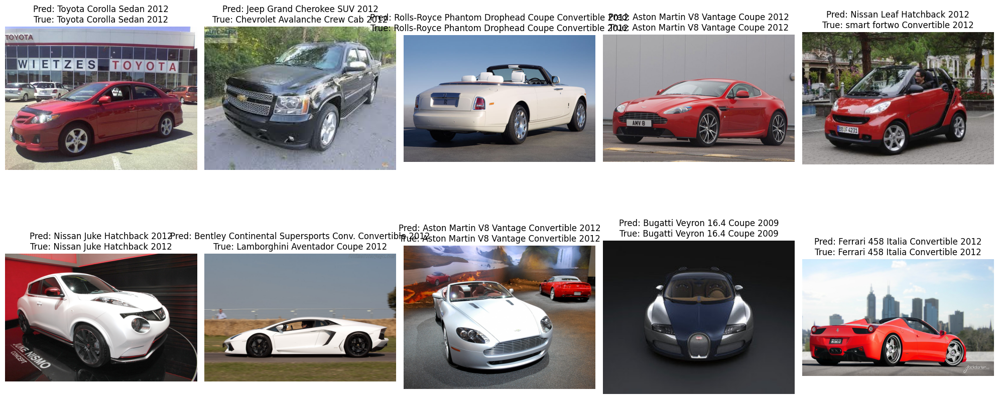

In [30]:
random_indices = random.sample(range(len(test_generator.filenames)), 10)

predictions = model_res.predict(test_generator, verbose=1)
predicted_classes = np.argmax(predictions, axis=1) 
true_classes = test_generator.classes  


class_labels = list(test_generator.class_indices.keys())


fig, axes = plt.subplots(2, 5, figsize=(20, 10))  

for i, idx in enumerate(random_indices):
    img_path = test_generator.filepaths[idx]  
    img = plt.imread(img_path) 
    
    row = i // 5
    col = i % 5
    axes[row, col].imshow(img)
    axes[row, col].axis('off')
    
    predicted_label = class_labels[predicted_classes[idx]]
    true_label = class_labels[true_classes[idx]]
    axes[row, col].set_title(f"Pred: {predicted_label}\nTrue: {true_label}")

plt.tight_layout()
plt.show()
